# Setting Source Folder

In [1]:
import os, sys

filedir = os.path.abspath(".")

currentdir = os.path.dirname(os.path.abspath(".")) # workaround to adding local modules

parentdir = os.path.dirname(os.path.abspath(""+currentdir))
print(f'CurrentDir: {currentdir}')
print(f'ParentDir: {parentdir}')

sys.path.insert(0, currentdir)

CurrentDir: /Users/renan.cristofalo/Documents/git/machine-learning-saude
ParentDir: /Users/renan.cristofalo/Documents/git


# IMPORTAÇÃO DAS BIBLIOTECAS

In [2]:
# pip install tensorflow-metal==0.5.0 tensorflow-macos==2.9

In [3]:
# What version of Python do you have?
import sys

import tensorflow.keras
import pandas as pd
import sklearn as sk
import tensorflow as tf
import platform

print(f"Python Platform: {platform.platform()}")
print(f"Tensor Flow Version: {tf.__version__}")
print(f"Keras Version: {tensorflow.keras.__version__}")
print()
print(f"Python {sys.version}")
print(f"Pandas {pd.__version__}")
print(f"Scikit-Learn {sk.__version__}")
gpu = len(tf.config.list_physical_devices('GPU'))>0
print("GPU is", "available" if gpu else "NOT AVAILABLE")

# For M1 computers = https://www.youtube.com/watch?v=5DgWvU0p2bk&ab_channel=JeffHeaton

Python Platform: macOS-13.0.1-arm64-arm-64bit
Tensor Flow Version: 2.9.0
Keras Version: 2.9.0

Python 3.9.15 | packaged by conda-forge | (main, Nov 22 2022, 08:48:25) 
[Clang 14.0.6 ]
Pandas 1.3.0
Scikit-Learn 1.1.2
GPU is available


In [4]:
import pandas as pd
import numpy as np
import joblib
import os.path as osp
import logging

from src.visualization.data_visualization import *
from src.ml.model_selection import cross_validate_models, _create_metric_msg, create_df_results, RandomizedSearch, make_dnn_model
from src.ml.utils.preprocessors import select_preprocessor
from src.ml.utils.utils import write_joblib, read_joblib
from src.utils.utils import now_str
from src.ml.evaluation.evaluate import get_metric_result

from sklearn.preprocessing import MinMaxScaler,StandardScaler, FunctionTransformer, PowerTransformer

from sklearn.pipeline import Pipeline
from sklearn.base import clone

from scikeras.wrappers import KerasClassifier

#Models
from sklearn.dummy import DummyClassifier
from sklearn.linear_model import RidgeClassifier, LogisticRegression
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier, LGBMRegressor #conda install lightgbm==3.3.2
from catboost import CatBoostClassifier
# from ngboost import NGBClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, ExtraTreesClassifier, VotingClassifier, StackingClassifier
from sklearn.tree import DecisionTreeClassifier


from tensorflow.python.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint

# explicitly require this experimental feature
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer, SimpleImputer

# import packages for imbalanced learn
from imblearn.combine import SMOTEENN
from imblearn.pipeline import Pipeline as Imb_Pipeline
from imblearn.ensemble import RUSBoostClassifier, BalancedRandomForestClassifier

import warnings
warnings.filterwarnings("ignore")

pd.options.display.float_format = '{:,.2f}'.format
%matplotlib inline

In [5]:
N_FOLDS = 5
SEED=42
MODELS_DIR = osp.join('models','v2')
TARGET = 'hospital_death'

# Definining Logs

In [6]:
def define_logs(logs_path):
    """ Define the logs for the model selector

    Args:
        logs_path (str): Path to the log file
    """
    folder_path = osp.dirname(osp.abspath(logs_path))
    if not osp.exists(folder_path):
        os.makedirs(folder_path)

    log = logging.getLogger()
    log.setLevel(logging.INFO)
    fh = logging.FileHandler(filename=logs_path)
    fh.setLevel(logging.INFO)
    formatter = logging.Formatter(
                    fmt='%(asctime)s %(levelname)s: %(message)s',
                    datefmt='%Y-%m-%d %H:%M:%S'
                    )
    fh.setFormatter(formatter)
    log.addHandler(fh)
    
    return log

In [7]:
logger = define_logs(osp.join(MODELS_DIR,'logs',f'{now_str()}-model_selection.logs'))

In [8]:
import json
def is_jsonable(x):
    try:
        json.dumps(x)
        return True
    except (TypeError, OverflowError):
        return False

# Model Training

## Defining Strategies

In [9]:
ALL_PATH = osp.join ('..','data','feature_selection', 'raw')
BORUTA_PATH = osp.join ('..','data','feature_selection', 'boruta')
FS_PATH = osp.join ('..','data','feature_selection', 'fs')
FS_SMOTEENN_PATH = osp.join ('..','data','feature_selection', 'smoteenn')

STRATEGIES = {

    'ALL_FEATURES':{ 
        'description': "Training with all available features",
        'df_train' : osp.join(ALL_PATH, 'df_train.parquet'),
        'df_test' : osp.join(ALL_PATH, 'df_test.parquet'),
    },
    
    'BORUTA':{ 
        'description': "Training with features selected by the Boruta Feature Selection",
        'df_train' : osp.join(BORUTA_PATH, 'df_train.parquet'),
        'df_test' : osp.join(BORUTA_PATH, 'df_test.parquet'),
    },
    
    'FS':{ 
        'description': "Training with features selected by the Feature Selector",
        'df_train' : osp.join(FS_PATH, 'df_train.parquet'),
        'df_test' : osp.join(FS_PATH, 'df_test.parquet'),
    },
       
    'FS_SMOTEENN':{ 
        'description': "Training with filtered features selected by the Feature Selector combined with sampler SMOTEENN",
        'df_train' : osp.join(FS_SMOTEENN_PATH, 'df_train.parquet'),
        'df_test' : osp.join(FS_SMOTEENN_PATH, 'df_test.parquet'),
        'imbalanced_sampler': SMOTEENN(random_state=42),
    }
}
for strategy, dict_strategy in STRATEGIES.items():
    logger.info(f'\n*************** {strategy} ***************\n')  
    logger.info(json.dumps({k:(str(v) if not is_jsonable(v) else v) for k,v in dict_strategy.items()} , sort_keys = False, indent = 3, skipkeys=True))
    
    # getting strategy parameters
    df_train_path = dict_strategy.get('df_train', None)
    df_test_path = dict_strategy.get('df_test', None)
    
    # reading files
    df_train=pd.read_parquet(df_train_path)
    df_test=pd.read_parquet(df_test_path)
    
    logger.info(f'\ndf_train shape: {df_train.shape} \n df_test shape: {df_test.shape}\n')

## Defining Metrics

In [10]:
metrics={
        'accuracy'      :   'accuracy',
        'balanced_acc'  :   'balanced_accuracy',
        'F1'            :   'f1',
        'Precision'     :   'precision',
        'recall'        :   'recall',
        'roc_auc'       :   'roc_auc',
        } 

## Defining Sklearn Models

In [11]:
models = []

# Make a pipeline for the model, scaling and making a cross validation for each of them
models.append({'name':"Dummy"
             , 'model': DummyClassifier()
             })

models.append({'name':"LogisticRegression"
             , 'model': LogisticRegression()
             })

models.append({'name':"DecisionTreeClassifier"
             , 'model': DecisionTreeClassifier(min_samples_split=0.005, min_samples_leaf=0.001,random_state=SEED)
             })

models.append({'name':"RandomForestClassifier"
             , 'model': RandomForestClassifier(max_depth = 10, random_state = SEED, min_samples_split = 0.01, min_samples_leaf = 0.005)
             })

models.append({'name':"ExtraTreesClassifier"
             , 'model': ExtraTreesClassifier(max_depth = 10, random_state = SEED, min_samples_split = 0.01, min_samples_leaf = 0.005)
             })

models.append({'name':"GradientBoostingClassifier"
             , 'model': GradientBoostingClassifier(max_depth = 10, random_state = SEED, min_samples_split = 0.01, min_samples_leaf = 0.005)
             }) 

models.append({'name':"XGBoostClassifier"
             , 'model': XGBClassifier(max_depth = 10, random_state = SEED)
             }) 

models.append({'name':"LGBMClassifier"
             , 'model': LGBMClassifier(max_depth=10)
             }) 

models.append({'name':"CatBoostClassifier"
             , 'model': CatBoostClassifier(max_depth=10, verbose=False)
             }) 

models.append({'name':"BalancedRandomForestClassifier"
             , 'model': BalancedRandomForestClassifier(random_state = SEED)
             }) 

models.append({'name':"RUSBoostClassifier"
             , 'model': RUSBoostClassifier(random_state = SEED)
             }) 

models.append({'name':"VotingClassifier"
             , 'model': VotingClassifier(estimators = [
                ('rf', RandomForestClassifier(n_estimators=10, random_state=42)),
                ('lgbm', LGBMClassifier(max_depth=10)),
                ('catboost',CatBoostClassifier(max_depth=10, verbose=False)),
                ('xgboost',XGBClassifier(max_depth=10, random_state = SEED)),
            ], voting = 'soft')
            }) 

models.append({'name':"StackingClassifier"
             , 'model': StackingClassifier(estimators = [
                ('rf', RandomForestClassifier(n_estimators=10, random_state=42)),
                ('xgboost',XGBClassifier(max_depth=10, random_state = SEED)),
                ('lgbm', LGBMClassifier(max_depth=10)),
            ])
            }) 


## Defining Tensorflow Models

In [12]:
PATIENCE=5
NUM_EPOCHS = 30

BATCH_SIZE=1024
seed = 42
verbose=0


callbacks ={
'EarlyStopping': tf.keras.callbacks.EarlyStopping,
}
tf_metrics = ['accuracy'] #https://www.tensorflow.org/api_docs/python/tf/keras/metrics

models.append({'name':"DNN_01"
             , 'model': KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (1024, 1024, 512, 512),
               dropout_rate = 0.3,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=0.2,
               verbose=0
               )
             }) 

models.append({'name':"DNN_02"
             , 'model': KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (1024, 512, 256, 128, 64, 32),
               dropout_rate = 0.2,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=0.2,
               verbose=0
               )
             }) 

models.append({'name':"DNN_03"
             , 'model': KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (128, 64, 32),
               dropout_rate = 0.1,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=0.2,
               verbose=0
               )
             }) 

models.append({'name':"DNN_04"
             , 'model': KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (32, 16, 8),
               dropout_rate = 0.1,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=0.2,
               verbose=0
               )
             }) 


models.append({'name':"VotingClassifierDNN_01"
             , 'model': VotingClassifier(estimators = [
                ('rf', RandomForestClassifier(n_estimators=10, random_state=42)),
                ('lgbm', LGBMClassifier(max_depth=10)),
                ('DNN_01',KerasClassifier(
               model = make_dnn_model,
               optimizer = 'adam',
               network_layers = (1024, 1024, 512, 512),
               dropout_rate = 0.3,
               epochs=NUM_EPOCHS,
               batch_size = BATCH_SIZE,
               callbacks=callbacks,
               callbacks__EarlyStopping__monitor='val_loss', 
               callbacks__EarlyStopping__patience=PATIENCE, 
               callbacks__EarlyStopping__restore_best_weights=True,
               validation_split=0.2,
               verbose=0
               )),
            ], voting = 'soft')
            }) 



## Running Models' Training

In [ ]:
for strategy, dict_strategy in STRATEGIES.items():
    
    # logging strategy
    logger.info(f'*************** {strategy} ***************')  
    logger.info(json.dumps({k:(str(v) if not is_jsonable(v) else v)for k,v in dict_strategy.items() } , sort_keys = False, indent = 4, skipkeys=True))
      
    # getting strategy parameters
    df_train_path = dict_strategy.get('df_train', None)
    df_test_path = dict_strategy.get('df_test', None)
    imbalanced_sampler = dict_strategy.get('imbalanced_sampler', None)
    
    # reading files
    df_train=pd.read_parquet(df_train_path)
    df_test=pd.read_parquet(df_test_path)
    
    logger.info(f'df_train shape: {df_train.shape}')
    logger.info(f'df_test shape: {df_test.shape}')   
    
    X_train_= df_train.drop([TARGET], axis=1)
    y_train_ = df_train[TARGET]
    X_test_ = df_test.drop([TARGET], axis=1)
    y_test_ = df_test[TARGET]

    # Adding preprocessor
    preprocessor = None
    preprocessor = select_preprocessor('TargetEncoding', X = X_train_)
    
    strategy_models = []
    if imbalanced_sampler:
        df_train=pd.read_parquet(df_train_path).sample(10000)
        X_train_= df_train.drop([TARGET], axis=1)
        y_train_ = df_train[TARGET]
        
        for model in models:
            strategy_models.append({
                'name': strategy + '_' + model['name'],
                'model': Imb_Pipeline(steps = [
                    ('preprocessor', preprocessor),
                    ('sampling', imbalanced_sampler),
                    ('model', model['model'])
                ])
            })
    else:
        for model in models:
            strategy_models.append({
                'name': strategy + '_' + model['name'],
                'model': Pipeline(steps = [
                    ('preprocessor', preprocessor),
                    ('model', model['model'])
                ])
            })
    
    names, results, df_results = cross_validate_models(
        models = strategy_models
        , X_train = X_train_
        , y_train = y_train_
        , X_test = X_test_
        , y_test = y_test_
        , metrics = metrics
        , n_folds = N_FOLDS
        , models_dir = MODELS_DIR
        )

In [13]:
trained_models, results = {},{}
for strategy, dict_strategy in STRATEGIES.items():
    for model in models:
        try:
            trained_models[strategy + "_" + model['name']] = read_joblib(osp.join(MODELS_DIR, strategy + "_" + model['name'],'model.p'))
            metric_dict = read_joblib(osp.join(MODELS_DIR, strategy + "_" + model['name'],'metrics.p'))
            results.update(metric_dict)
        except:
            pass

    write_joblib(results, osp.join(MODELS_DIR, f"results.p"))
    results = read_joblib(osp.join(MODELS_DIR,'results.p'))

Metal device set to: Apple M1 Pro

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB



2022-12-13 10:54:39.982482: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2022-12-13 10:54:39.982595: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [14]:
for name, model_metric in results.items():
    msg_metrics = _create_metric_msg(model_metric)

    # print of the result of each model
    print(f"\nAVERAGES - {name.upper()}:\n" + msg_metrics)
    logger.info(f"\nAVERAGES - {name.upper()}:\n" + msg_metrics)


AVERAGES - ALL_FEATURES_DUMMY:
 - ACCURACY               ->  - TRAIN: 0.91 (+/- 0.00) | VALIDATION: 0.91 (+/- 0.00) | TEST: 0.91 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - F1                     ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - PRECISION              ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - RECALL                 ->  - TRAIN: 0.00 (+/- 0.00) | VALIDATION: 0.00 (+/- 0.00) | TEST: 0.00 (+/- 0.00)
 - ROC_AUC                ->  - TRAIN: 0.50 (+/- 0.00) | VALIDATION: 0.50 (+/- 0.00) | TEST: 0.50 (+/- 0.00)
 - FIT TIME FOR EACH FOLD ->  - TRAIN: 0.16s (+/- 0.03s)


AVERAGES - ALL_FEATURES_LOGISTICREGRESSION:
 - ACCURACY               ->  - TRAIN: 0.93 (+/- 0.00) | VALIDATION: 0.92 (+/- 0.00) | TEST: 0.92 (+/- 0.00)
 - BALANCED_ACC           ->  - TRAIN: 0.63 (+/- 0.00) | VALIDATION: 0.63 (+/- 0.00) | TEST: 0.62 (+/-

In [15]:
df_results = create_df_results(results, models=None, slim=False)
df_results_slim = create_df_results(results, models=None, slim=True)

In [16]:
metrics = df_results.select_dtypes(float).columns.to_list()

compare_model_results(
    df=df_results,
    names="models",
    metrics=metrics,
    save_path=osp.join('figures','compare_models.png')

)

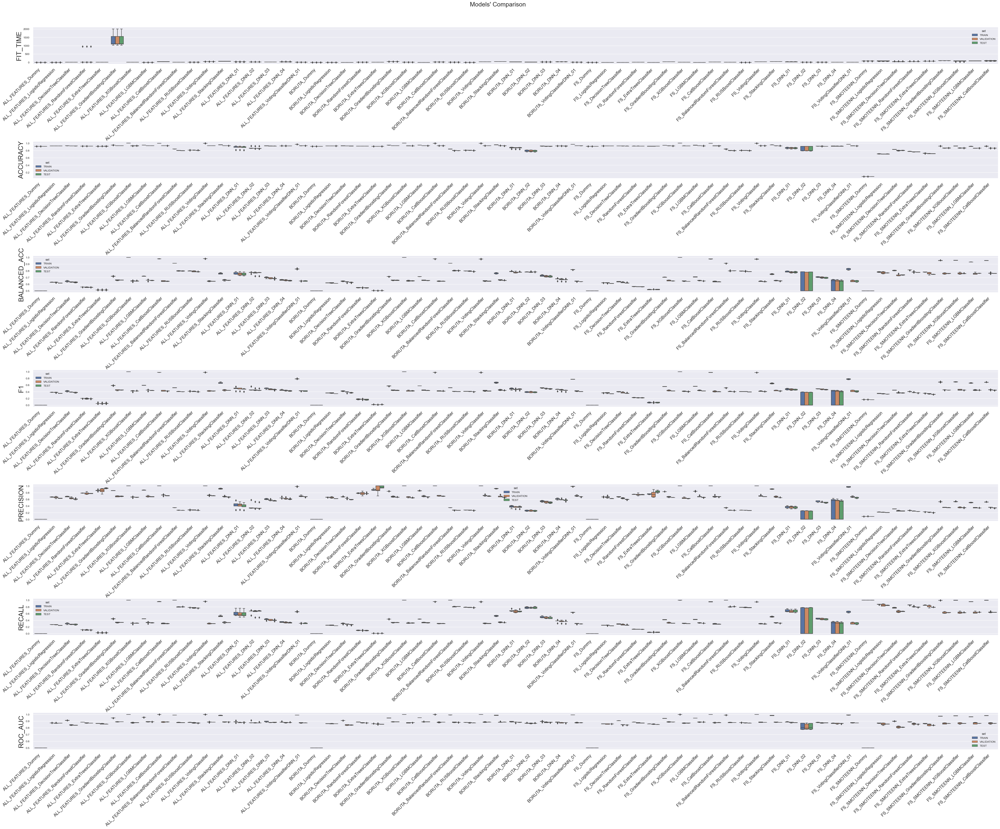

In [17]:
metrics = df_results_slim.select_dtypes(float).columns.to_list()

compare_model_results(
    df=df_results_slim,
    names="models",
    metrics=metrics,
    save_path=osp.join('figures','compare_models_slim.png'),
    hue='set'

)

# Analyzing the Results

In [18]:
df_results.sample(10)

,models,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
121,BORUTA_DecisionTreeClassifier,0.65,0.92,0.93,0.92,0.63,0.65,0.64,0.38,0.43,0.40,0.60,0.67,0.63,0.28,0.32,0.29,0.84,0.91,0.84
36,ALL_FEATURES_Dummy,0.14,0.91,0.91,0.91,0.50,0.50,0.50,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.50,0.50,0.50
176,BORUTA_XGBoostClassifier,5.68,0.93,1.00,0.93,0.65,1.00,0.65,0.44,1.00,0.43,0.65,1.00,0.66,0.33,1.00,0.32,0.88,1.00,0.88
149,BORUTA_LogisticRegression,0.32,0.92,0.92,0.92,0.61,0.62,0.62,0.34,0.36,0.36,0.62,0.66,0.68,0.23,0.25,0.25,0.86,0.86,0.87
188,FS_CatBoostClassifier,18.41,0.93,1.00,0.93,0.64,0.97,0.64,0.41,0.97,0.40,0.68,1.00,0.66,0.29,0.95,0.29,0.88,1.00,0.88
203,FS_DNN_03,11.04,0.91,0.92,0.92,0.70,0.71,0.71,0.47,0.49,0.49,0.49,0.53,0.51,0.45,0.47,0.46,0.88,0.88,0.88
75,ALL_FEATURES_VotingClassifier,45.65,0.93,1.00,0.93,0.64,0.98,0.64,0.42,0.98,0.41,0.71,1.00,0.72,0.30,0.96,0.28,0.88,1.00,0.89
85,ALL_FEATURES_XGBoostClassifier,8.69,0.93,1.00,0.92,0.65,1.00,0.63,0.43,1.00,0.39,0.67,1.00,0.64,0.32,1.00,0.28,0.88,1.00,0.87
52,ALL_FEATURES_LGBMClassifier,0.98,0.93,0.95,0.93,0.66,0.72,0.66,0.44,0.59,0.45,0.67,0.87,0.70,0.33,0.44,0.33,0.89,0.96,0.88
41,ALL_FEATURES_ExtraTreesClassifier,2.60,0.92,0.92,0.92,0.51,0.51,0.51,0.04,0.05,0.04,0.93,0.87,0.83,0.02,0.03,0.02,0.85,0.87,0.85


In [19]:
df_results.groupby(['models']).mean().nlargest(10,'VALIDATION_ROC_AUC').sort_values('VALIDATION_ROC_AUC',ascending=False)

,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
models,,,,,,,,,,,,,,,,,,,
ALL_FEATURES_LGBMClassifier,1.05,0.93,0.95,0.93,0.65,0.72,0.66,0.44,0.59,0.45,0.68,0.87,0.69,0.32,0.45,0.33,0.89,0.96,0.89
ALL_FEATURES_GradientBoostingClassifier,"1,354.51",0.93,0.95,0.93,0.66,0.72,0.66,0.45,0.59,0.45,0.69,0.86,0.69,0.34,0.44,0.33,0.89,0.95,0.89
BORUTA_GradientBoostingClassifier,42.36,0.93,0.94,0.93,0.66,0.71,0.66,0.44,0.57,0.45,0.66,0.84,0.68,0.33,0.44,0.33,0.89,0.95,0.89
BORUTA_LGBMClassifier,0.63,0.93,0.94,0.93,0.65,0.71,0.66,0.44,0.58,0.45,0.67,0.85,0.69,0.32,0.43,0.33,0.89,0.95,0.89
ALL_FEATURES_StackingClassifier,61.74,0.93,0.95,0.93,0.66,0.76,0.66,0.44,0.67,0.45,0.67,0.92,0.68,0.33,0.52,0.33,0.89,0.98,0.89
FS_GradientBoostingClassifier,35.67,0.93,0.94,0.93,0.65,0.70,0.66,0.42,0.55,0.44,0.65,0.83,0.67,0.31,0.42,0.33,0.89,0.94,0.89
ALL_FEATURES_CatBoostClassifier,37.42,0.93,1.00,0.93,0.64,0.98,0.65,0.42,0.98,0.43,0.71,1.00,0.73,0.30,0.96,0.30,0.89,1.00,0.89
FS_LGBMClassifier,0.69,0.93,0.94,0.93,0.65,0.71,0.65,0.42,0.56,0.44,0.65,0.84,0.69,0.31,0.42,0.32,0.89,0.95,0.89
ALL_FEATURES_VotingClassifier,46.35,0.93,1.00,0.93,0.64,0.98,0.65,0.42,0.98,0.42,0.71,1.00,0.72,0.30,0.96,0.30,0.89,1.00,0.89


In [20]:
df_results.groupby(['models']).mean().nlargest(5,'VALIDATION_F1').sort_values('VALIDATION_F1',ascending=False)

,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
models,,,,,,,,,,,,,,,,,,,
BORUTA_DNN_03,19.86,0.91,0.92,0.92,0.71,0.73,0.72,0.48,0.52,0.49,0.50,0.54,0.52,0.47,0.50,0.48,0.88,0.89,0.88
ALL_FEATURES_DNN_01,28.69,0.88,0.89,0.88,0.75,0.76,0.75,0.47,0.49,0.48,0.41,0.44,0.42,0.59,0.61,0.60,0.88,0.89,0.88
ALL_FEATURES_DNN_03,18.23,0.92,0.93,0.92,0.68,0.70,0.69,0.46,0.50,0.47,0.55,0.60,0.57,0.40,0.42,0.40,0.88,0.89,0.88
FS_DNN_03,9.96,0.91,0.92,0.92,0.70,0.71,0.70,0.46,0.49,0.47,0.50,0.53,0.52,0.43,0.45,0.44,0.87,0.88,0.87
BORUTA_DNN_01,25.09,0.87,0.87,0.87,0.78,0.79,0.78,0.47,0.49,0.47,0.36,0.38,0.36,0.68,0.69,0.67,0.88,0.89,0.88


In [21]:
df_results.groupby(['models']).mean().nlargest(5,'VALIDATION_BALANCED_ACC').sort_values('VALIDATION_BALANCED_ACC',ascending=False)

,FIT_TIME,TEST_ACCURACY,TRAIN_ACCURACY,VALIDATION_ACCURACY,TEST_BALANCED_ACC,TRAIN_BALANCED_ACC,VALIDATION_BALANCED_ACC,TEST_F1,TRAIN_F1,VALIDATION_F1,TEST_PRECISION,TRAIN_PRECISION,VALIDATION_PRECISION,TEST_RECALL,TRAIN_RECALL,VALIDATION_RECALL,TEST_ROC_AUC,TRAIN_ROC_AUC,VALIDATION_ROC_AUC
models,,,,,,,,,,,,,,,,,,,
BORUTA_BalancedRandomForestClassifier,2.01,0.80,0.84,0.80,0.80,0.91,0.80,0.41,0.52,0.41,0.27,0.35,0.27,0.81,1.00,0.80,0.88,0.99,0.88
FS_BalancedRandomForestClassifier,1.96,0.80,0.84,0.80,0.80,0.91,0.80,0.40,0.52,0.41,0.27,0.35,0.27,0.81,1.00,0.80,0.88,0.99,0.88
ALL_FEATURES_BalancedRandomForestClassifier,2.72,0.80,0.84,0.80,0.80,0.91,0.80,0.40,0.52,0.41,0.27,0.35,0.27,0.80,1.00,0.80,0.88,0.99,0.88
BORUTA_RUSBoostClassifier,1.03,0.80,0.80,0.80,0.79,0.80,0.79,0.40,0.41,0.41,0.27,0.28,0.28,0.78,0.79,0.78,0.87,0.88,0.88
FS_RUSBoostClassifier,0.94,0.80,0.80,0.80,0.79,0.80,0.79,0.39,0.41,0.41,0.26,0.27,0.27,0.78,0.79,0.78,0.87,0.88,0.87


In [22]:
SELECTED_MODELS = sorted([col for col in results.keys() if 'Dummy' not in col and results[col]['ROC_AUC']['VALIDATION'].mean() > 0.87])
THRESHOLD = 0.5

In [23]:
# reading files

df_train=pd.read_parquet(osp.join(ALL_PATH, 'df_train.parquet'))
df_test=pd.read_parquet(osp.join(ALL_PATH, 'df_test.parquet'))

logger.info(f'df_train shape: {df_train.shape}')
logger.info(f'df_test shape: {df_test.shape}')   

X_train= df_train.drop([TARGET], axis=1)
y_train = df_train[TARGET]
X_test = df_test.drop([TARGET], axis=1)
y_test = df_test[TARGET]

In [24]:
predictions = {}
predictions_proba = {}
for name, model in trained_models.items():
    if name in SELECTED_MODELS:
        predictions[name] = model.predict(X_test)
        predictions_proba[name] = model.predict_proba(X_test)[:,1]

2022-12-13 10:55:23.566860: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-12-13 10:55:23.602854: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-12-13 10:55:24.310308: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-12-13 10:55:25.040326: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-12-13 10:55:25.631511: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-12-13 10:55:26.312765: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.
2022-12-13 10:55:29.313635: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113

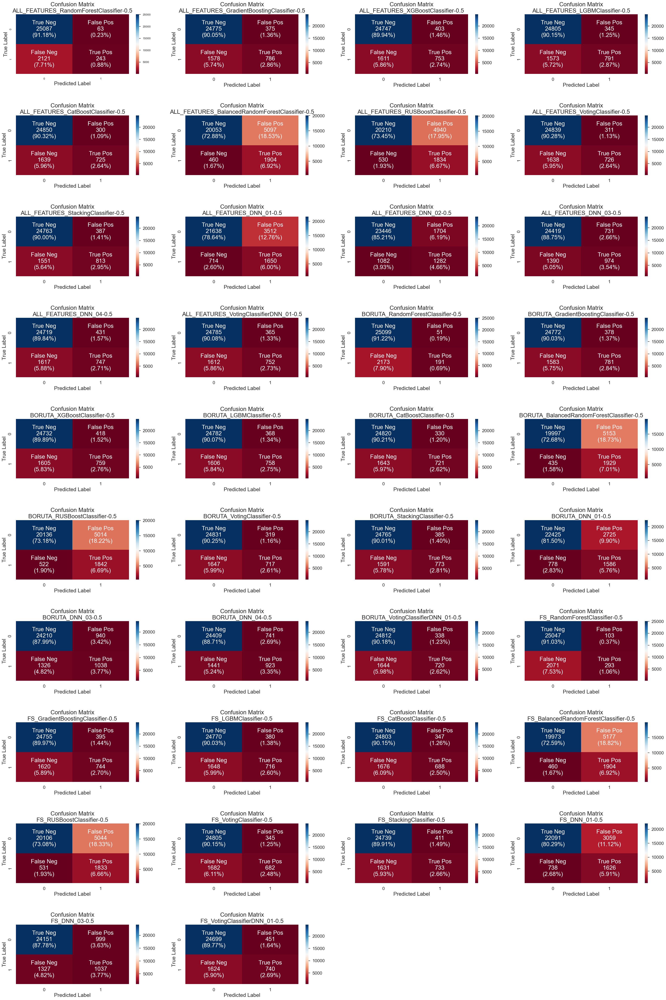

In [25]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_confusion_matrix(y_real = y_test, y_pred= y_pred, title=f'Confusion Matrix\n{name}-{round(THRESHOLD,2)}', ax = ax)

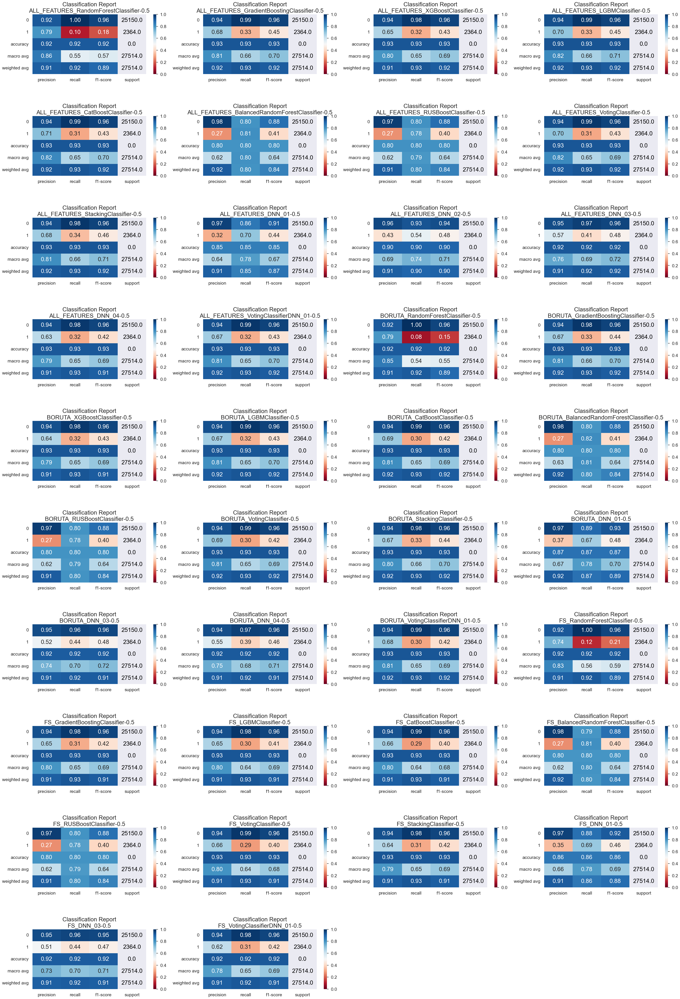

In [26]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_classification_report_sns(y_real = y_test, y_pred= y_pred, title=f'Classification Report\n{name}-{round(THRESHOLD,2)}', ax = ax)

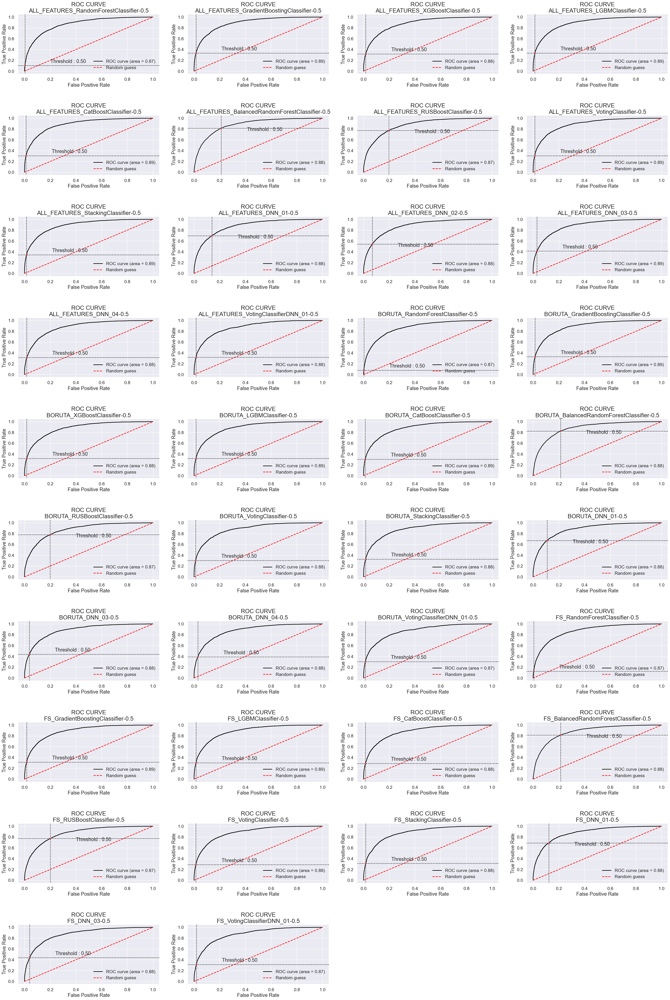

In [27]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_roc_sns(y_real = y_test, y_pred= y_pred, title=f'ROC CURVE\n{name}-{round(THRESHOLD,2)}', ax = ax)

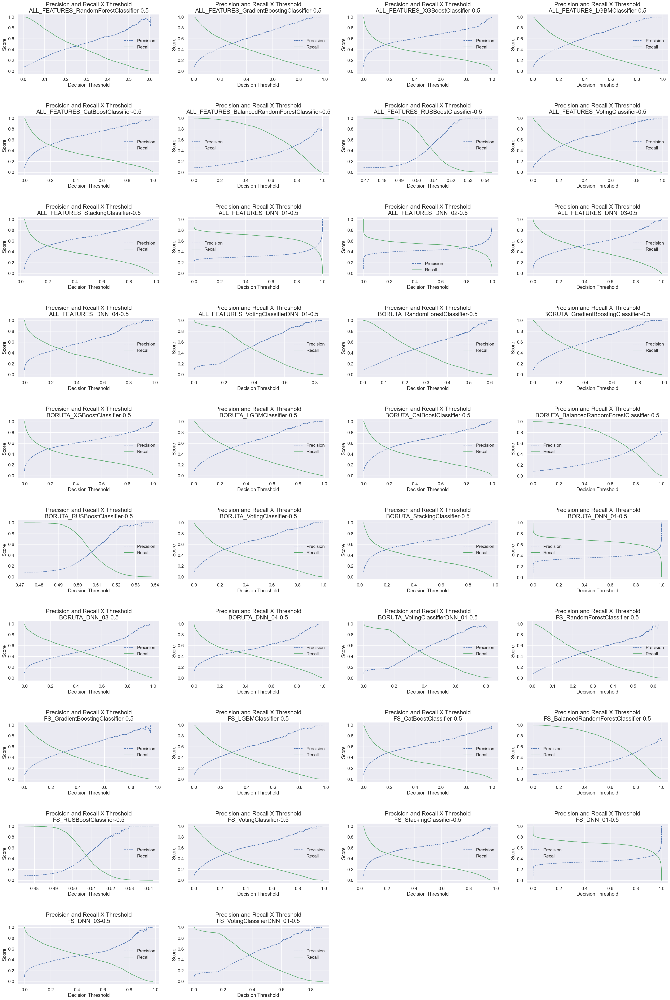

In [28]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_precision_recall_vs_threshold(y_real = y_test, y_pred= y_pred, title=f'Precision and Recall X Threshold\n{name}-{round(THRESHOLD,2)}', ax = ax)

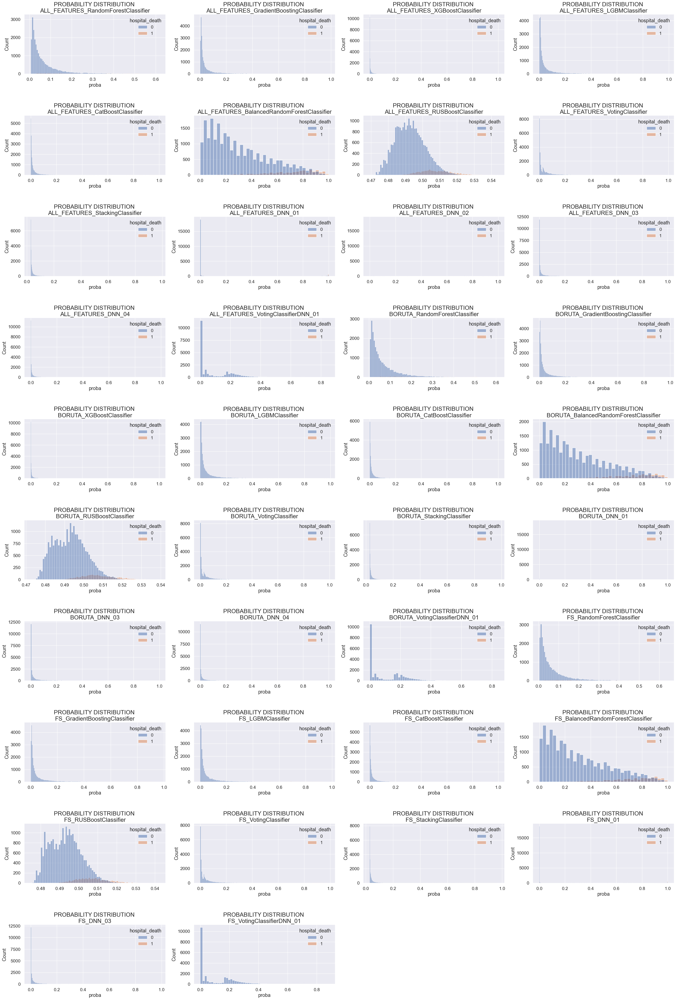

In [29]:
import seaborn as sns

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    df_proba = pd.concat([pd.Series(y_pred, name = 'proba', index = y_test.index), y_test], axis = 1)
    try:
        sns.histplot(data = df_proba, x = 'proba', hue = y_test.name, ax = ax)
        ax.set_title(f'PROBABILITY DISTRIBUTION \n{name}', fontsize=20)
    except:
        pass

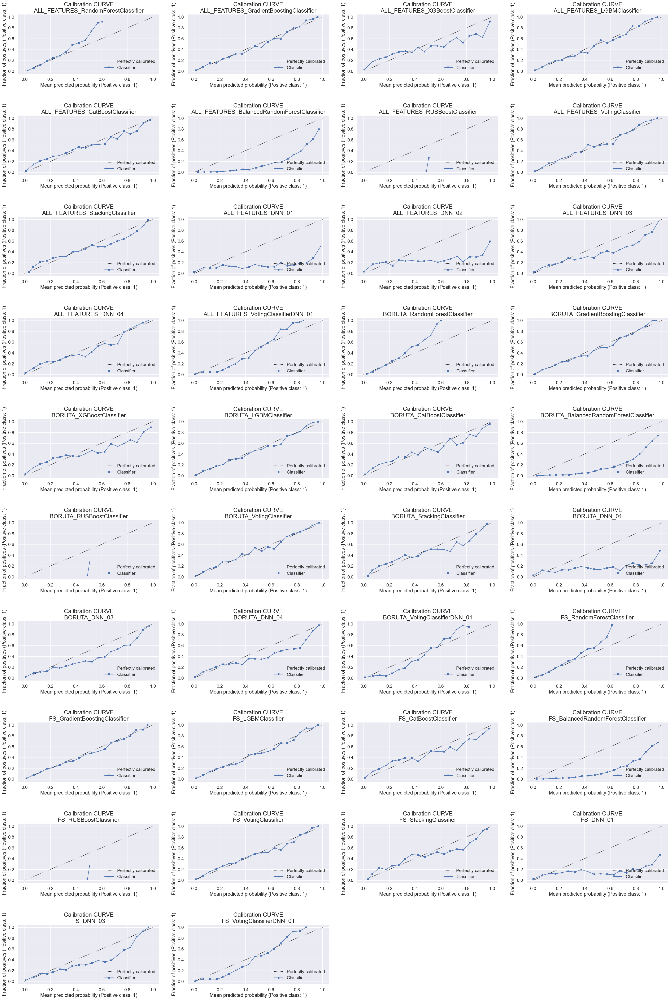

In [30]:
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    plot_calibration_curve(y_real = y_test, y_pred= y_pred, title=f'Calibration CURVE\n{name}', ax = ax, n_bins=20)

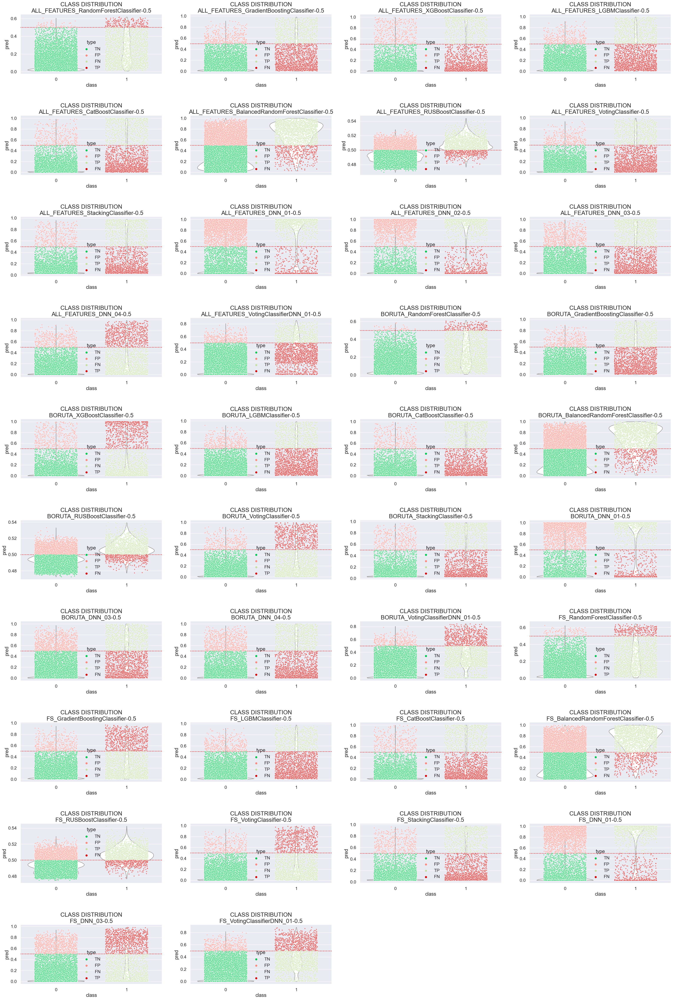

In [31]:
from plot_metric.functions import BinaryClassification
import matplotlib.pyplot as plt
import math

ncols = 4

size=len(predictions_proba)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, (name, y_pred) in enumerate(predictions_proba.items(), start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    bc = BinaryClassification(y_true = y_test, y_pred= y_pred, labels=["Class 0", "Class 1"], threshold = THRESHOLD)
    bc.plot_class_distribution()
    title: ax.set_title(f'CLASS DISTRIBUTION\n{name}-{round(THRESHOLD,2)}', fontsize=20)

# Tunning Hyperparameters

In [59]:
chosen_model_name = "BORUTA_LGBMClassifier"

chosen_model  = read_joblib(osp.join(MODELS_DIR, chosen_model_name ,'model.p'))
pipe = clone(chosen_model)

In [60]:
# reading files

df_train=pd.read_parquet(osp.join(BORUTA_PATH, 'df_train.parquet'))
df_test=pd.read_parquet(osp.join(BORUTA_PATH, 'df_test.parquet'))

logger.info(f'df_train shape: {df_train.shape}')
logger.info(f'df_test shape: {df_test.shape}')   

X_train= df_train.drop([TARGET], axis=1)
y_train = df_train[TARGET]
X_test = df_test.drop([TARGET], axis=1)
y_test = df_test[TARGET]

In [61]:
pipe

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('float',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['d1_mbp_min',
                                                   'd1_potassium_min',
                                                   'd1_heartrate_max',
                                                   'd1_sysbp_max', 'weight',
                                                   'd1_glucose_min',
                                                   'apache_4a_hospital_death_prob',
                                                   'd1_heartrate_min',
                                                   'd1_resprate_min',
                                                   'h1_resprate_min'...
                                                                                 handle_unknown='ignore'))]),
                                                  ['apache_3j_bodysystem']),
                                                 ('categorical_high_granularity',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(fill_value='missing',
                                                                                 strategy='constant')),
                                                                  ('encoder',
                                                                   TargetEncoder())]),
                                                  []),
                                                 ('bypass',
                                                  Pipeline(steps=[('Bypass',
                                                                   <src.ml.utils.preprocessors.BypassTransformer object at 0x2b0c88280>)]),
                                                  [])])),
                ('model', LGBMClassifier(max_depth=10))])

## Randomized Search CV

In [96]:
preprocessor_search_space = {
    'preprocessor__float__imputer': [
        SimpleImputer(strategy="constant", fill_value=0),
        # SimpleImputer(strategy="constant", fill_value=np.nan),
        SimpleImputer(strategy="mean"),
        SimpleImputer(strategy="median"),                                                   
        # IterativeImputer(
        #     random_state=0
        #     , estimator=LGBMRegressor(max_depth = 3, random_state=SEED)
        #     , max_iter=10
        #     , tol=1e-1
        #     )
        ],
                
    'preprocessor__float__scaler': [
        FunctionTransformer(),            
        # FunctionTransformer(func = np.log1p, inverse_func = np.expm1),            
        PowerTransformer(method='yeo-johnson', standardize=False),            
        # PowerTransformer(method='box-cox', standardize=False),            
        MinMaxScaler(),
        StandardScaler()
        ],
    
    'preprocessor__int__imputer': [
        SimpleImputer(strategy="constant", fill_value=0),
        # SimpleImputer(strategy="constant", fill_value=np.nan),
        SimpleImputer(strategy="most_frequent"),
        SimpleImputer(strategy="mean"),
        SimpleImputer(strategy="median"),                                                   
        # IterativeImputer(
        #     random_state=0
        #     , estimator=LGBMRegressor(max_depth = 3, random_state=SEED)
        #     , max_iter=10
        #     , tol=1e-1
        #     )
        ],
    
    'preprocessor__int__scaler': [
        FunctionTransformer(),            
        # FunctionTransformer(func = np.log1p, inverse_func = np.expm1),            
        PowerTransformer(method='yeo-johnson', standardize=False),            
        # PowerTransformer(method='box-cox', standardize=False),            
        MinMaxScaler(),
        StandardScaler()
    ]
}

In [97]:
search_space = [              
    {'model': [LGBMClassifier(random_state=SEED)],
        'model__n_estimators': [30, 100, 400, 700, 1000],
        'model__colsample_bytree': [0.7, 0.8],
        'model__max_depth': [3, 5, 10, 15, 20],
        'model__num_leaves': [50, 100, 200],
        'model__reg_alpha': [1.1, 1.2, 1.3],
        'model__reg_lambda': [1.1, 1.2, 1.3],
        'model__min_split_gain': [0.3, 0.4],
        'model__min_child_samples': [10, 20, 30, 40, 50],
        'model__subsample': [0.7, 0.8, 0.9],
        'model__subsample_freq': [20, 10],
    **preprocessor_search_space
    }
]

In [98]:
SAMPLE_SIZE = 1000000

X_train_sample = X_train.sample(min(SAMPLE_SIZE,X_train.shape[0]))
# X_train_sample = X_train
y_train_sample = y_train.loc[X_train_sample.index]            

optimizer = None
optimizer=RandomizedSearch(pipe=pipe
            , search_space=search_space
            , X_train=X_train_sample
            , y_train=y_train_sample
            , scoring=metrics
            , refit = 'roc_auc'
            , n_iter=100
            , n_folds=N_FOLDS
            , verbose = 1
            )

print('Finished fitting optimizer')
best_model = optimizer.best_estimator_

print('Retraining best model')

best_model.fit(X_train, y_train)

write_joblib(best_model, osp.join(MODELS_DIR, 'best_model.joblib'))


Fitting 5 folds for each of 100 candidates, totalling 500 fits
Finished fitting optimizer
Retraining best model


In [99]:
best_model

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('float',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(fill_value=0,
                                                                                 strategy='constant')),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['d1_mbp_min',
                                                   'd1_potassium_min',
                                                   'd1_heartrate_max',
                                                   'd1_sysbp_max', 'weight',
                                                   'd1_glucose_min',
                                                   'apache_4a_hospital_death_prob',
                                                   'd1_heartrate_min',
                                                   'd1...
                                                                  ('encoder',
                                                                   TargetEncoder())]),
                                                  []),
                                                 ('bypass',
                                                  Pipeline(steps=[('Bypass',
                                                                   <src.ml.utils.preprocessors.BypassTransformer object at 0x2b7b87be0>)]),
                                                  [])])),
                ('model',
                 LGBMClassifier(colsample_bytree=0.7, max_depth=3,
                                min_child_samples=10, min_split_gain=0.3,
                                n_estimators=700, num_leaves=50,
                                random_state=42, reg_alpha=1.3, reg_lambda=1.3,
                                subsample=0.9, subsample_freq=20))])

In [100]:
y_pred_train = best_model.predict(X_train)
y_proba_train = best_model.predict_proba(X_train)
y_pred_test = best_model.predict(X_test)
y_proba_test = best_model.predict_proba(X_test)

max_metric_len = max([len(metric_name) for metric_name in metrics])
msg_metrics = f""
for metric_name, scorer in metrics.items():
    
    train_scorer = get_metric_result(
        scorer, y_train, y_pred_train,y_proba=y_proba_train
    )
    test_scorer = get_metric_result(
        scorer, y_test, y_pred_test, y_proba=y_proba_test
    )

    msg_metrics += f" - {metric_name.upper()}{' '*(max_metric_len-len(metric_name))}\t->\tTRAIN: {train_scorer:.2f} | TEST:{test_scorer:.2f}\n"
    
print(msg_metrics)

 - ACCURACY    	->	TRAIN: 0.94 | TEST:0.93
 - BALANCED_ACC	->	TRAIN: 0.70 | TEST:0.66
 - F1          	->	TRAIN: 0.55 | TEST:0.44
 - PRECISION   	->	TRAIN: 0.83 | TEST:0.68
 - RECALL      	->	TRAIN: 0.41 | TEST:0.33
 - ROC_AUC     	->	TRAIN: 0.93 | TEST:0.89



# Best Model

In [120]:
best_model  = read_joblib(osp.join(MODELS_DIR, 'best_model.joblib'))

name = chosen_model_name

y_pred_train = best_model.predict(X_train)
y_proba_train = best_model.predict_proba(X_train)[:,1]
y_pred_test = best_model.predict(X_test)
y_proba_test = best_model.predict_proba(X_test)[:,1]

In [121]:
y = y_test
y_pred = y_pred_test
y_proba = y_proba_test

## Metrics

### Precision and Recall x Threshold

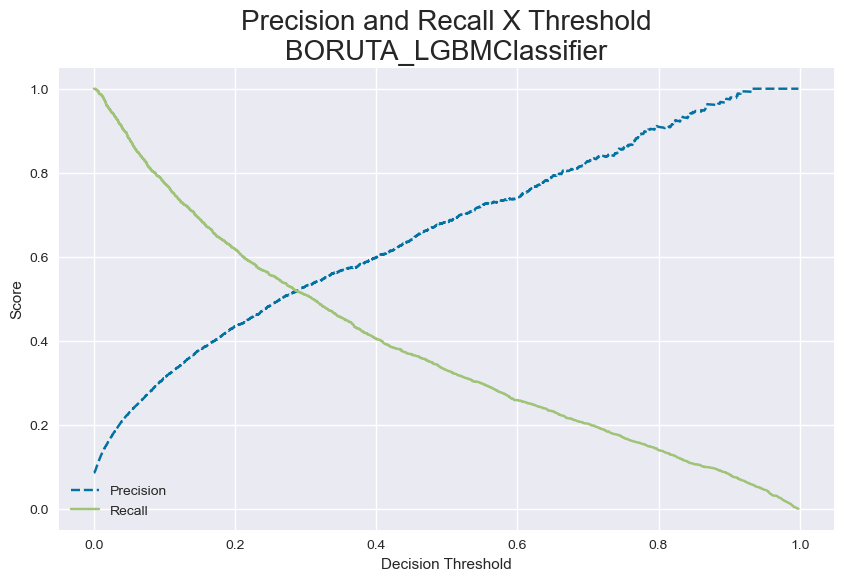

In [128]:
import matplotlib.pyplot as plt
import math

width, height = (10,6)

fig = plt.figure(figsize=(min(width, 50),height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

ax = fig.add_subplot(1, 1, 1)

plot_precision_recall_vs_threshold(y_real = y, y_pred= y_proba, title=f'Precision and Recall X Threshold\n{name}', ax = ax)

### Calibration Curve

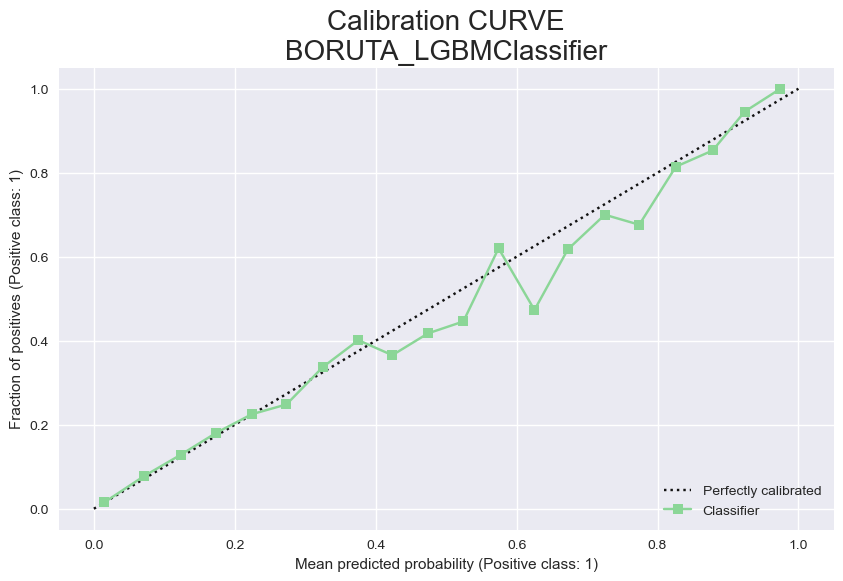

In [129]:
width, height = (10,6)

fig = plt.figure(figsize=(min(width, 50),height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

ax = fig.add_subplot(1, 1, 1)

plot_calibration_curve(y_real = y, y_pred= y_proba, title=f'Calibration CURVE\n{name}', ax = ax, n_bins=20)

### Probability Distribution

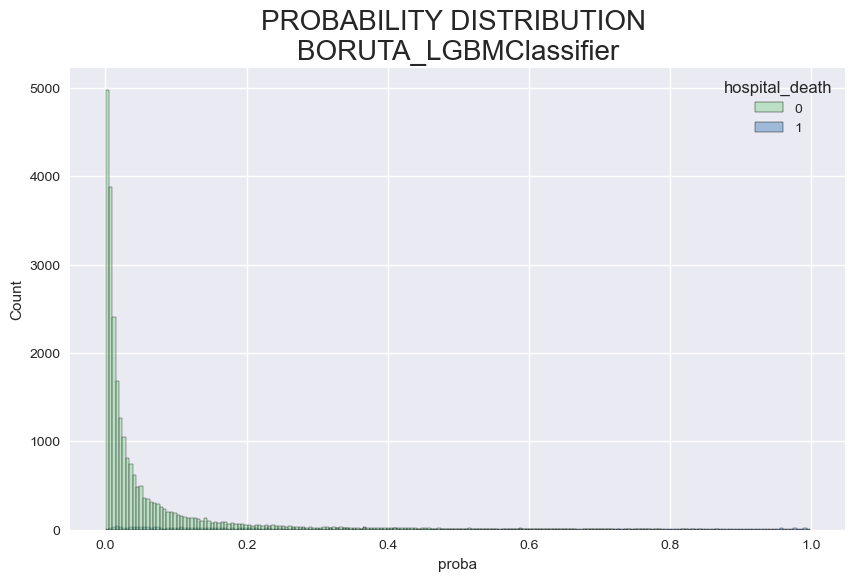

In [130]:
width, height = (10,6)

fig = plt.figure(figsize=(min(width, 50),height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

ax = fig.add_subplot(1, 1, 1)

df_proba = pd.concat([pd.Series(y_proba, name = 'proba', index = y.index), y], axis = 1)

sns.histplot(data = df_proba, x = 'proba', hue = y.name, ax = ax)
ax.set_title(f'PROBABILITY DISTRIBUTION \n{name}', fontsize=20)

plt.show()

### Confusion Matrix x Threshold

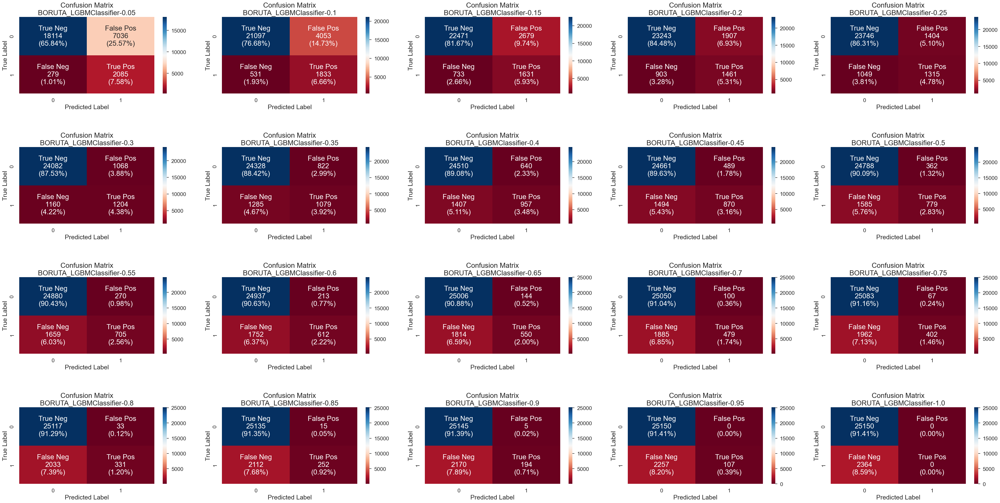

In [132]:
import matplotlib.pyplot as plt
import math

ncols = 5
THRESHOLDS = np.arange(0.05,1.05,0.05)

size=len(THRESHOLDS)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, threshold in enumerate(THRESHOLDS, start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    y_pred_threshold = best_model.predict_proba(X_test)[:,1]>threshold
    plot_confusion_matrix(y_real = y, y_pred= y_pred_threshold, title=f'Confusion Matrix\n{name}-{round(threshold,2)}', ax = ax)

### Classification Report x Threshold

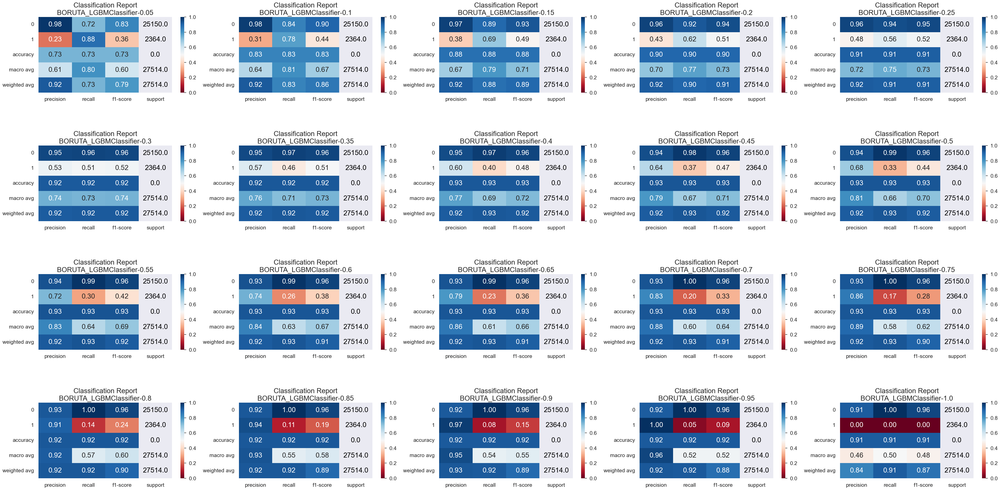

In [137]:
import matplotlib.pyplot as plt
import math

ncols = 5
THRESHOLDS = np.arange(0.05,1.05,0.05)

size=len(THRESHOLDS)
rows=math.ceil(size/ncols)
width, height = (10,6)

fig = plt.figure(figsize=(min(ncols*width, 50),rows*height))
fig.subplots_adjust(hspace=0.7, wspace=0.2)

for idx, threshold in enumerate(THRESHOLDS, start=1):
    ax = fig.add_subplot(rows, ncols, idx)
    y_pred_threshold = best_model.predict_proba(X_test)[:,1]>threshold
    plot_classification_report_sns(y_real = y, y_pred= y_pred_threshold, title=f'Classification Report\n{name}-{round(threshold,2)}', ax = ax)

### Defining Threshold

In [145]:
THRESHOLD = 0.35
y_pred = best_model.predict_proba(X_test)[:,1]>THRESHOLD

### Confusion Matrix

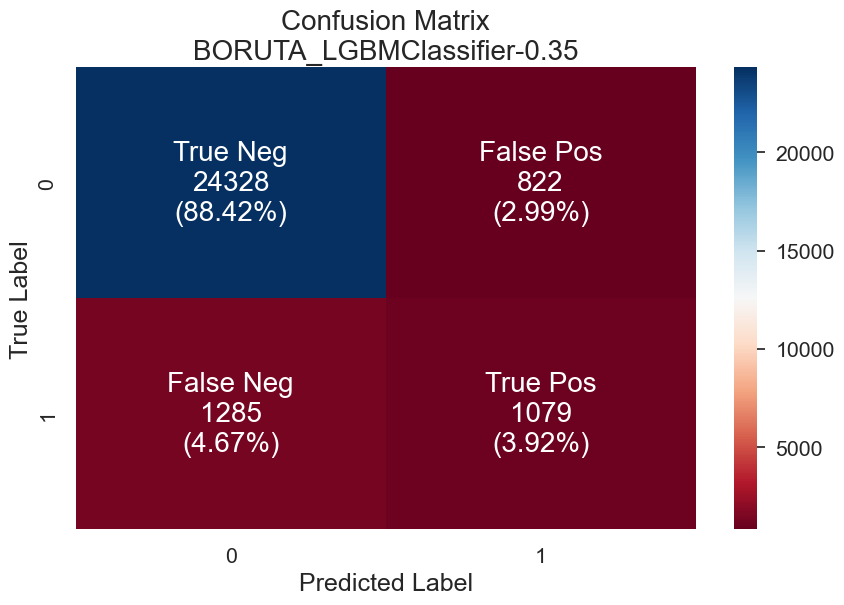

In [146]:
plot_confusion_matrix(y_real =y, y_pred= y_pred, title=f'Confusion Matrix\n{name}-{round(THRESHOLD,2)}')

### Classification Report

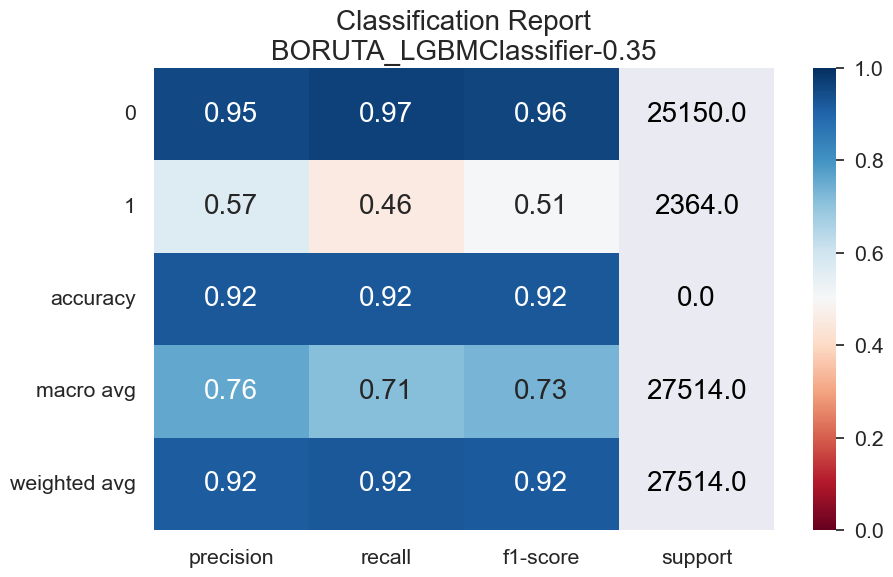

In [147]:
plot_classification_report_sns(y_real = y, y_pred= y_pred, title=f'Classification Report\n{name}-{round(THRESHOLD,2)}')

### Roc Curve

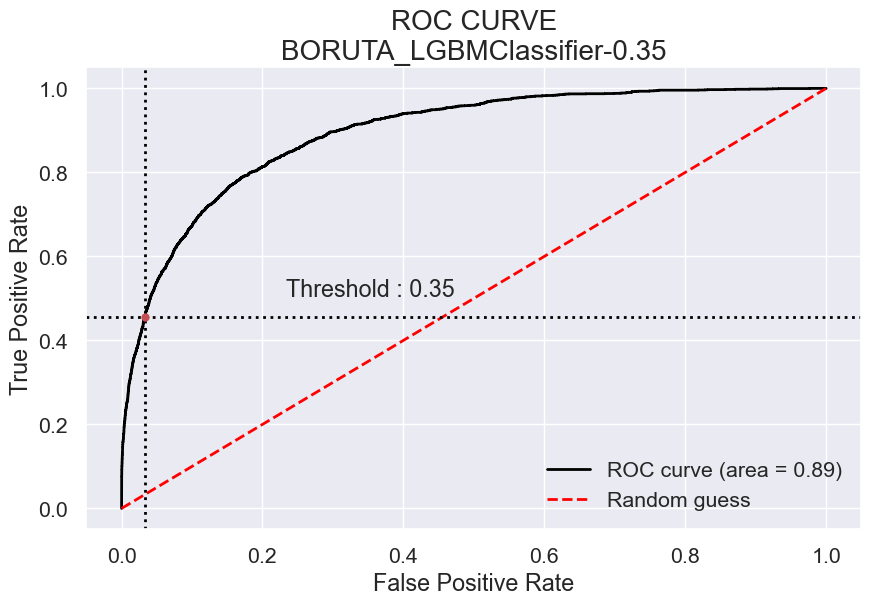

In [149]:
from plot_metric.functions import BinaryClassification
f, ax = plt.subplots(figsize=(10,6 ))
bc = BinaryClassification(y_true = y, y_pred= y_proba, labels=["Class 1", "Class 2"], threshold = THRESHOLD)
bc.plot_roc_curve()
title: ax.set_title(f'ROC CURVE\n{name}-{round(THRESHOLD,2)}', fontsize=20)

### Precision x Recall

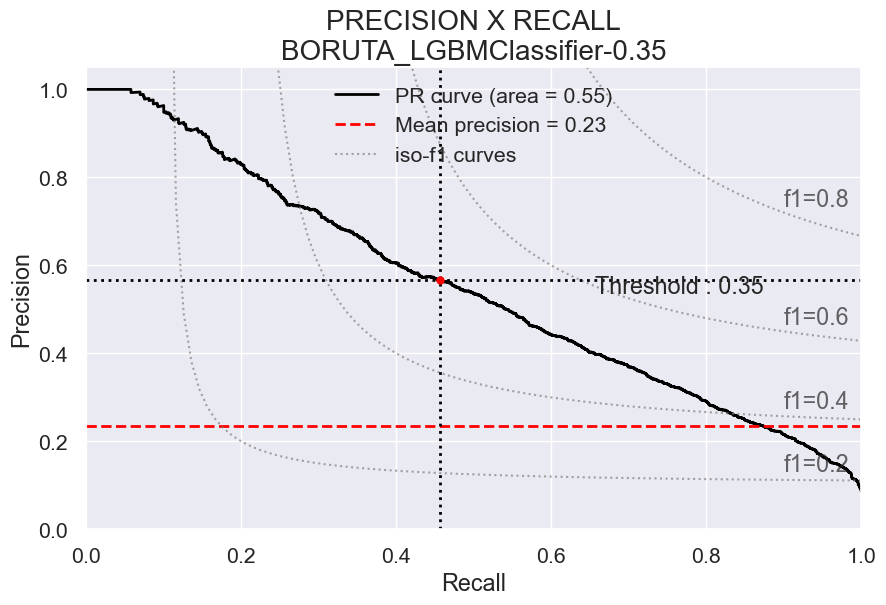

In [151]:
from plot_metric.functions import BinaryClassification
f, ax = plt.subplots(figsize=(10,6 ))
bc = BinaryClassification(y_true = y, y_pred= y_proba, labels=["Class 0", "Class 1"], threshold = THRESHOLD)
bc.plot_precision_recall_curve()
title: ax.set_title(f'PRECISION X RECALL\n{name}-{round(THRESHOLD,2)}', fontsize=20)

### Class Distribution

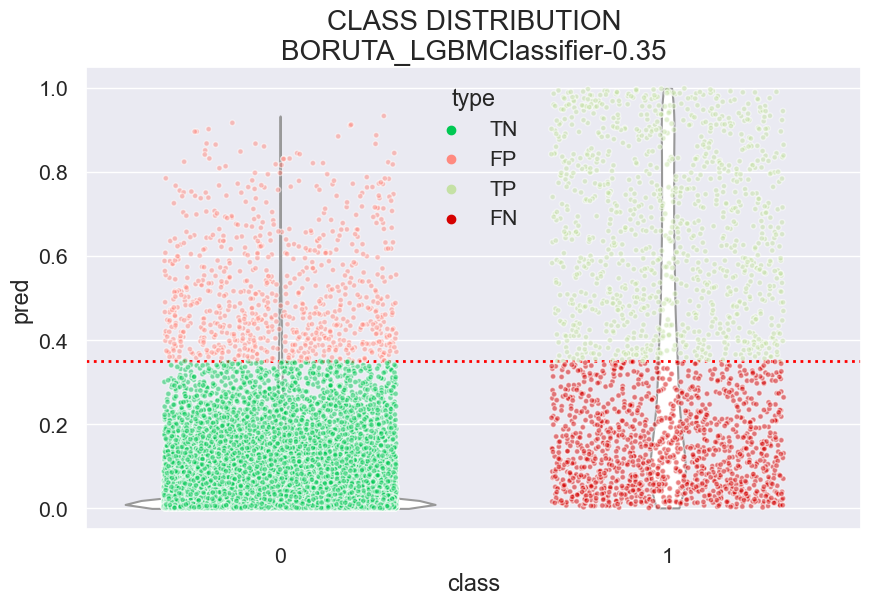

In [153]:
from plot_metric.functions import BinaryClassification
f, ax = plt.subplots(figsize=(10,6 ))
bc = BinaryClassification(y_true = y, y_pred= y_proba, labels=["Class 0", "Class 1"], threshold = THRESHOLD)
bc.plot_class_distribution()
title: ax.set_title(f'CLASS DISTRIBUTION\n{name}-{round(THRESHOLD,2)}', fontsize=20)

## Shap

In [154]:
import shap

shap.initjs()

model = best_model

# Using a random sample of the dataframe for better time computation
X_train_sampled = X_train.sample(30, random_state=10)
X_test_sampled = X_test.sample(1000, random_state=10)

# explain the model's predictions using SHAP values
def model_predict(data_asarray, model = model, columns=X_train_sampled.columns):
    data_asframe = pd.DataFrame(data_asarray, columns=columns)
    predictions = model.predict_proba(data_asframe)
    return predictions

explainer = shap.KernelExplainer(model = model_predict, data = X_train_sampled, link = "identity")
shap_values = explainer.shap_values(X_test_sampled)

  0%|          | 0/1000 [00:00<?, ?it/s]

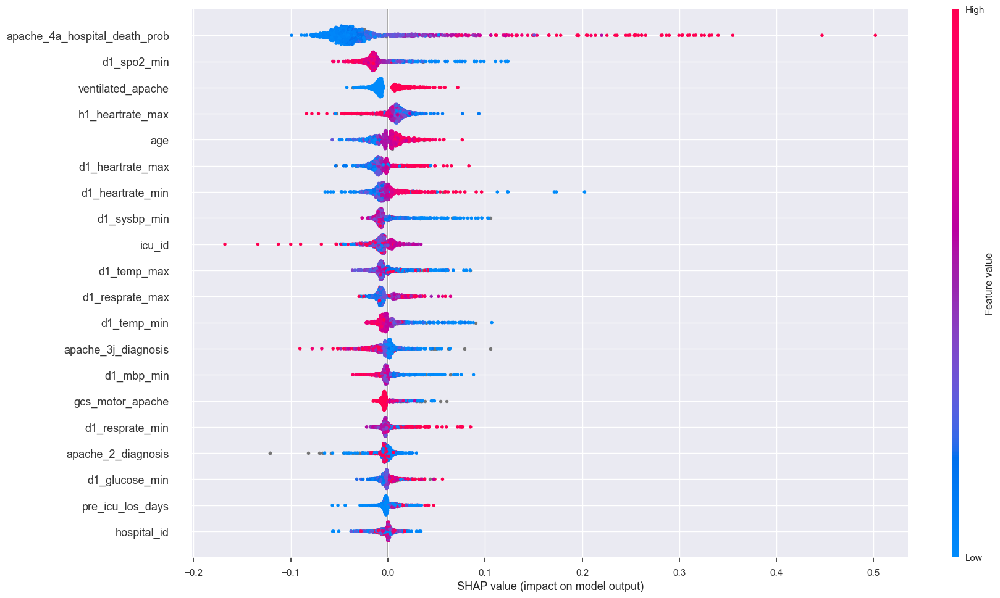

In [169]:
shap.summary_plot(shap_values[1], X_test_sampled, plot_size = (18,10))

In [168]:
shap.force_plot(explainer.expected_value[0], shap_values[0][0], feature_names = X_train_sampled.columns, link = 'logit')

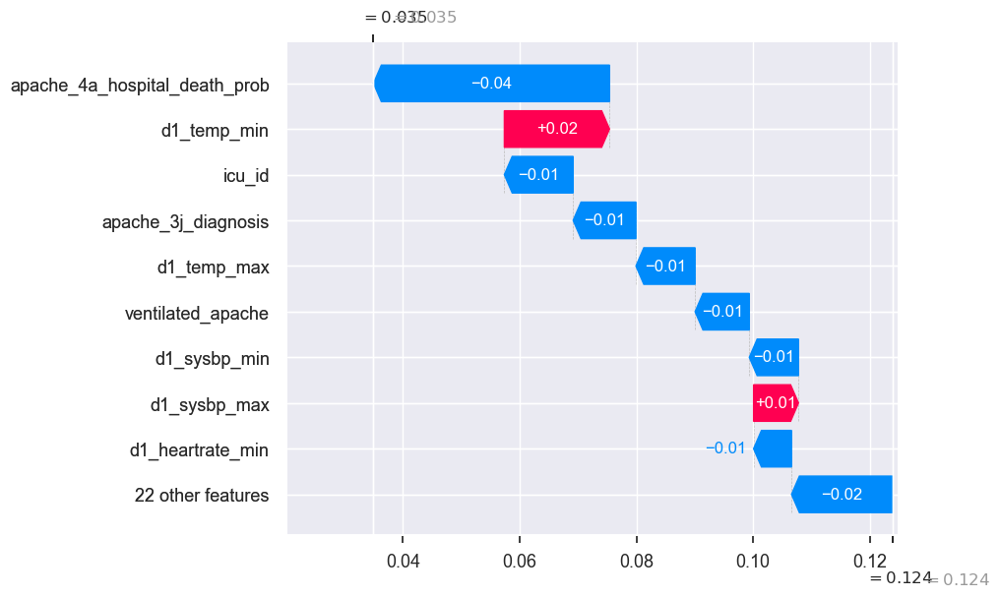

In [166]:
shap.plots._waterfall.waterfall_legacy(explainer.expected_value[1], shap_values[1][0], feature_names= X_train_sampled.columns)

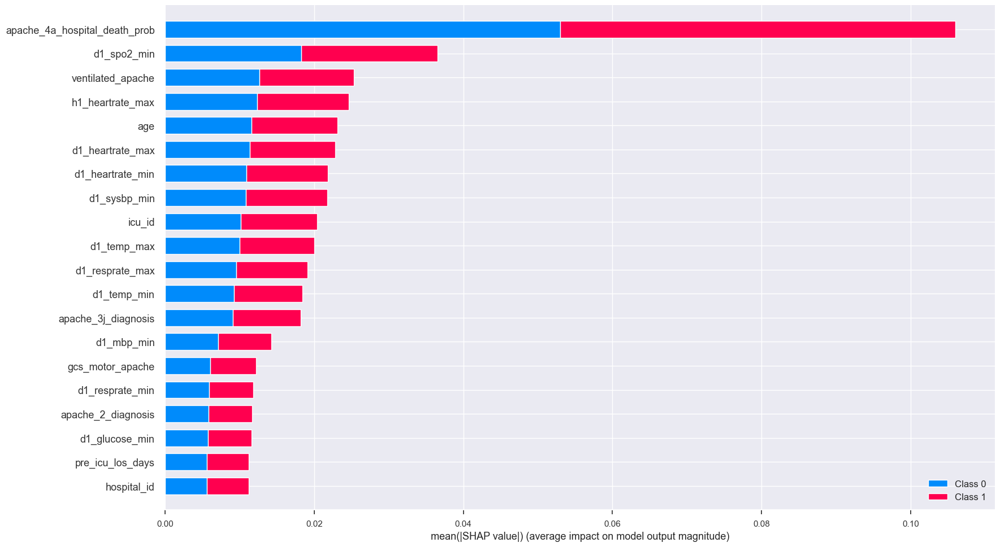

In [171]:
shap.summary_plot(shap_values, plot_type = 'bar', feature_names = X_train_sampled.columns, plot_size=(18,10))

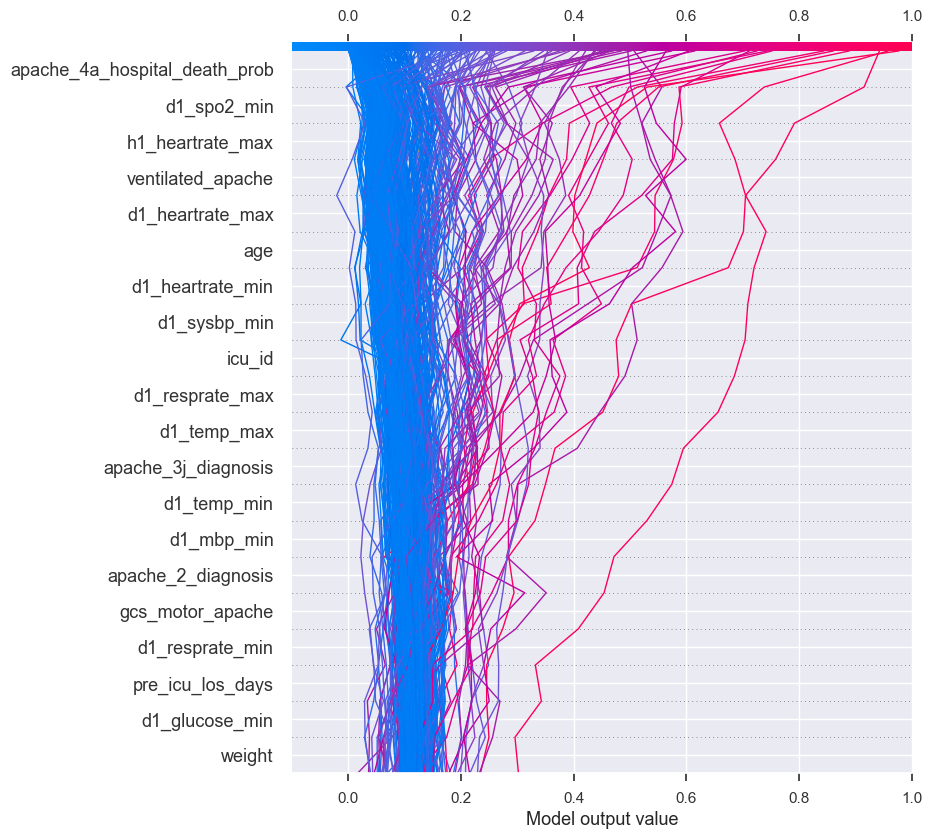

In [177]:
shap.decision_plot(explainer.expected_value[1], shap_values[1][:500], feature_names = X_test_sampled.columns.to_list(), xlim = (-0.1,1),
                   feature_order = 'hclust')

In [176]:
shap.plots.force(explainer.expected_value[1], shap_values[1], feature_names = X_test_sampled.columns.to_list())